In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
datapath = "/Users/whysocurious/Documents/MLDSAIProjects/cust-seg-case-study/data"
# dfcust = pd.read_csv(datapath+'/customer_data_imputed.csv')
dfcust = pd.read_csv(datapath+'/Customer Segmentation DeDup.csv')
print (f"Data shape: {dfcust.shape}")
print (f"Data columns: {dfcust.columns.tolist()}")
print (f"Data types:\n{dfcust.dtypes}")
dfcust.head()

Data shape: (8363, 10)
Data columns: ['Unnamed: 0', 'Customer ID', 'Gender', 'Ever_Married', 'Age', 'Graduated', 'Profession', 'Work_Experience', 'Spending_Score', 'Family_Size']
Data types:
Unnamed: 0           int64
Customer ID          int64
Gender              object
Ever_Married        object
Age                  int64
Graduated           object
Profession          object
Work_Experience    float64
Spending_Score      object
Family_Size        float64
dtype: object


,Unnamed: 0,Customer ID,Gender,Ever_Married,Age,Graduated,Profession,Work_Experience,Spending_Score,Family_Size
0,0,458982,Male,Yes,61,Yes,Executive,1.0,High,3.0
1,1,458983,Female,Yes,63,Yes,Executive,0.0,High,5.0
2,2,458984,Male,Yes,39,Yes,Artist,0.0,Average,3.0
3,3,458985,Male,No,23,No,Healthcare,1.0,Low,4.0
4,4,458986,Male,No,18,No,Healthcare,7.0,Low,4.0


In [3]:
dfcust.isnull().sum()  # Check for missing values   

Unnamed: 0           0
Customer ID          0
Gender               0
Ever_Married       144
Age                  0
Graduated           80
Profession         128
Work_Experience    857
Spending_Score       0
Family_Size        344
dtype: int64

In [4]:
for col in dfcust.columns:
    if dfcust[col].dtype == 'object':
        print(f"Unique values in {col}: {dfcust[col].unique()[:5]}\n")  # Display first 5 unique values for object columns
    else:
        print(f"Statistics for {col}:\n{dfcust[col].describe()}\n")  # Display statistics for numerical columns

Statistics for Unnamed: 0:
count    8363.000000
mean     4181.000000
std      2414.334484
min         0.000000
25%      2090.500000
50%      4181.000000
75%      6271.500000
max      8362.000000
Name: Unnamed: 0, dtype: float64

Statistics for Customer ID:
count      8363.000000
mean     463474.382997
std        2597.369734
min      458982.000000
25%      461224.500000
50%      463468.000000
75%      465736.500000
max      467974.000000
Name: Customer ID, dtype: float64

Unique values in Gender: ['Male' 'Female']

Unique values in Ever_Married: ['Yes' 'No' nan]

Statistics for Age:
count    8363.000000
mean       43.838814
std        16.828683
min        18.000000
25%        31.000000
50%        41.000000
75%        53.000000
max        89.000000
Name: Age, dtype: float64

Unique values in Graduated: ['Yes' 'No' nan]

Unique values in Profession: ['Executive' 'Artist' 'Healthcare' 'Lawyer' 'Marketing']

Statistics for Work_Experience:
count    7506.000000
mean        2.644551
std      

<Axes: title={'center': 'Age Distribution'}, xlabel='Age_Bins'>

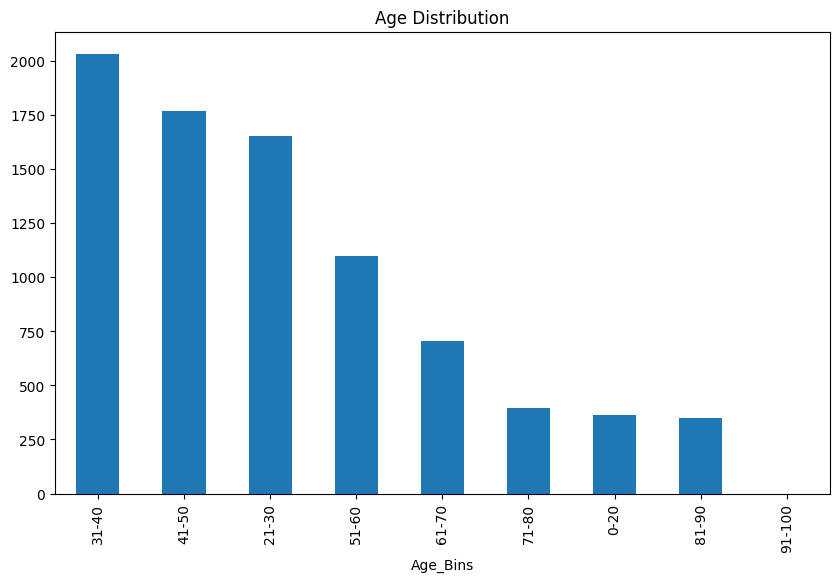

In [5]:
dfcust['Age_Bins'] = pd.cut(dfcust['Age'], bins=[0, 20, 30, 40, 50, 60, 70, 80, 90, 100], labels=['0-20', '21-30', '31-40', '41-50', '51-60', '61-70', '71-80', '81-90', '91-100'])
dfcust.Age_Bins.value_counts().plot(kind='bar', title='Age Distribution', figsize=(10, 6))

In [6]:
100 * (dfcust.pivot_table(index='Gender', columns='Profession', values='Customer ID', aggfunc='count') / dfcust.pivot_table(index='Gender', columns='Profession', values='Customer ID', aggfunc='count').sum())#.sum())

Profession,Artist,Doctor,Engineer,Entertainment,Executive,Healthcare,Homemaker,Lawyer,Marketing
Gender,,,,,,,,,
Female,48.427914,43.758766,80.0,26.849037,5.228758,41.678726,83.070866,49.306626,54.516129
Male,51.572086,56.241234,20.0,73.150963,94.771242,58.321274,16.929134,50.693374,45.483871


In [7]:
for col in dfcust.columns:
    if dfcust[col].isnull().any() and (col not in ['Customer ID', 'Age_Bins']):
        print(f"Missing values in {col}: {dfcust[col].isnull().sum()}")

Missing values in Ever_Married: 144
Missing values in Graduated: 80
Missing values in Profession: 128
Missing values in Work_Experience: 857
Missing values in Family_Size: 344


In [8]:
def display_percentage_table(dfcust, target_col, exclude_cols):
    """
    Display color-coded percentage tables for categorical variables vs target variable.
    
    Parameters:
    dfcust (DataFrame): Input dataframe
    target_col (str): Target column for comparison (default: 'Ever_Married')
    exclude_cols (list): Columns to exclude from analysis
    
    Returns:
    None (displays styled tables)
    """
    
    # Prepare target column
    dfcust[target_col] = dfcust[target_col].astype('str').fillna('Unknown')
    
    def color_map(val):
        """Color mapping based on percentage values with enhanced gradient"""
        if pd.isna(val):
            return 'background-color: white'
        elif val >= 90:
            return 'background-color: #a50026; color: white'  # Darkest red (90-100%)
        elif val >= 80:
            return 'background-color: #d73027; color: white'  # Dark red (80-89%)
        elif val >= 70:
            return 'background-color: #f46d43; color: white'  # Red-orange (70-79%)
        elif val >= 60:
            return 'background-color: #fdae61; color: black'  # Orange (60-69%)
        elif val >= 50:
            return 'background-color: #fee08b; color: black'  # Light orange (50-59%)
        elif val >= 40:
            return 'background-color: #e6f598; color: black'  # Yellow-green (40-49%)
        elif val >= 30:
            return 'background-color: #abdda4; color: black'  # Light green (30-39%)
        elif val >= 20:
            return 'background-color: #66c2a5; color: black'  # Green-blue (20-29%)
        elif val >= 10:
            return 'background-color: #abd9e9; color: black'  # Light blue (10-19%)
        elif val >= 5:
            return 'background-color: #74add1; color: white'  # Blue (5-9%)
        else:
            return 'background-color: #313695; color: white'  # Dark blue (0-4%)
    
    # Process each column
    for col in dfcust.columns:
        if col not in exclude_cols:
            print(f"\n{'='*60}")
            print(f"PERCENTAGE TABLE: {col} vs {target_col}")
            print('='*60)
            
            # Create crosstab
            crosstab = pd.crosstab(dfcust[col], dfcust[target_col])
            
            # Convert to percentages (row-wise percentages)
            percentage_table = crosstab.div(crosstab.sum(axis=1), axis=0) * 100
            
            # Round to 2 decimal places
            percentage_table = percentage_table.round(2)
            
            # Add total counts as additional info
            total_counts = crosstab.sum(axis=1)
            percentage_table['Total_Count'] = total_counts
            
            # Apply color coding and display
            styled_table = percentage_table.style.applymap(
                color_map, 
                subset=percentage_table.columns[:-1]  # Exclude Total_Count column from coloring
            ).format(precision=2)
            
            # Display the styled table
            display(styled_table)
            
            # Print summary statistics
            print(f"\nSummary for {col}:")
            print(f"- Number of categories: {len(percentage_table)}")
            print(f"- Total records: {total_counts.sum()}")
            print(f"- Categories: {list(percentage_table.index)}")

# Alternative version with different styling options
def display_percentage_table_simple(dfcust, target_col, exclude_cols):
    """
    Simple version without color coding for environments that don't support styling.
    """
    
    # Prepare target column
    dfcust[target_col] = dfcust[target_col].astype('str').fillna('Unknown')
    
    # Process each column
    for col in dfcust.columns:
        if col not in exclude_cols:
            print(f"\n{'='*60}")
            print(f"PERCENTAGE TABLE: {col} vs {target_col}")
            print('='*60)
            
            # Create crosstab
            crosstab = pd.crosstab(dfcust[col], dfcust[target_col])
            
            # Convert to percentages
            percentage_table = crosstab.div(crosstab.sum(axis=1), axis=0) * 100
            percentage_table = percentage_table.round(2)
            
            # Add total counts
            percentage_table['Total_Count'] = crosstab.sum(axis=1)
            
            # Display the table
            print(percentage_table)
            print(f"\nTotal records: {percentage_table['Total_Count'].sum()}")

# Usage example:
# display_percentage_table(dfcust)
# or for simple version:
# display_percentage_table_simple(dfcust)

In [9]:
pd.crosstab(dfcust.Age_Bins, dfcust.Work_Experience)

Work_Experience,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0,11.0,12.0,13.0,14.0
Age_Bins,,,,,,,,,,,,,,,
0-20,98,104,18,16,14,7,11,14,17,8,1,1,1,4,2
21-30,459,445,44,59,44,43,48,33,117,127,19,12,12,12,12
31-40,492,458,67,69,70,72,60,76,164,186,16,18,19,17,24
41-50,474,522,75,61,73,47,53,39,107,113,10,15,9,8,9
51-60,350,359,42,40,47,12,26,27,35,39,3,5,2,1,2
61-70,249,258,23,16,17,15,7,8,17,21,2,2,0,1,1
71-80,134,180,14,7,2,3,5,5,7,3,0,1,0,0,1
81-90,126,131,6,6,3,2,2,4,4,5,0,0,0,3,0


In [10]:
pd.crosstab(dfcust.Age_Bins, dfcust.Family_Size)

Family_Size,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0
Age_Bins,,,,,,,,,
0-20,2,30,104,108,62,21,7,3,3
21-30,176,310,356,382,192,76,36,31,19
31-40,409,608,372,313,150,58,26,9,8
41-50,393,517,319,301,118,30,16,6,7
51-60,191,315,221,219,79,27,6,1,5
61-70,137,306,119,75,28,6,5,2,3
71-80,98,197,39,19,8,2,3,0,1
81-90,103,195,23,6,1,0,1,0,0


In [11]:
for col in dfcust.columns:
    if col not in ['Customer ID', 'Age','Unnamed: 0']:
        display_percentage_table(dfcust, target_col=col, exclude_cols=['Customer ID', 'Age', col])  


PERCENTAGE TABLE: Unnamed: 0 vs Gender



Summary for Unnamed: 0:
- Number of categories: 8363
- Total records: 8363
- Categories: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203,

Gender,Female,Male,Total_Count
Ever_Married,,,
No,51.76,48.24,3412
Yes,40.36,59.64,4807



Summary for Ever_Married:
- Number of categories: 2
- Total records: 8219
- Categories: ['No', 'Yes']

PERCENTAGE TABLE: Graduated vs Gender


Gender,Female,Male,Total_Count
Graduated,,,
No,42.75,57.25,3132
Yes,46.83,53.17,5151



Summary for Graduated:
- Number of categories: 2
- Total records: 8283
- Categories: ['No', 'Yes']

PERCENTAGE TABLE: Profession vs Gender


Gender,Female,Male,Total_Count
Profession,,,
Artist,48.43,51.57,2608
Doctor,43.76,56.24,713
Engineer,80.00,20.00,720
Entertainment,26.85,73.15,987
Executive,5.23,94.77,612
Healthcare,41.68,58.32,1382
Homemaker,83.07,16.93,254
Lawyer,49.31,50.69,649
Marketing,54.52,45.48,310



Summary for Profession:
- Number of categories: 9
- Total records: 8235
- Categories: ['Artist', 'Doctor', 'Engineer', 'Entertainment', 'Executive', 'Healthcare', 'Homemaker', 'Lawyer', 'Marketing']

PERCENTAGE TABLE: Work_Experience vs Gender


Gender,Female,Male,Total_Count
Work_Experience,,,
0.000000,44.67,55.33,2382
1.000000,41.84,58.16,2457
2.000000,43.25,56.75,289
3.000000,48.18,51.82,274
4.000000,46.30,53.70,270
5.000000,44.28,55.72,201
6.000000,48.11,51.89,212
7.000000,49.51,50.49,206
8.000000,54.49,45.51,468



Summary for Work_Experience:
- Number of categories: 15
- Total records: 7506
- Categories: [0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0]

PERCENTAGE TABLE: Spending_Score vs Gender


Gender,Female,Male,Total_Count
Spending_Score,,,
Average,42.22,57.78,2044
High,40.46,59.54,1258
Low,47.66,52.34,5061



Summary for Spending_Score:
- Number of categories: 3
- Total records: 8363
- Categories: ['Average', 'High', 'Low']

PERCENTAGE TABLE: Family_Size vs Gender


Gender,Female,Male,Total_Count
Family_Size,,,
1.000000,55.00,45.00,1509
2.000000,44.43,55.57,2478
3.000000,41.66,58.34,1553
4.000000,39.35,60.65,1423
5.000000,40.91,59.09,638
6.000000,47.27,52.73,220
7.000000,53.00,47.00,100
8.000000,48.08,51.92,52
9.000000,45.65,54.35,46



Summary for Family_Size:
- Number of categories: 9
- Total records: 8019
- Categories: [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0]

PERCENTAGE TABLE: Age_Bins vs Gender


Gender,Female,Male,Total_Count
Age_Bins,,,
0-20,36.36,63.64,363
21-30,46.19,53.81,1654
31-40,49.48,50.52,2033
41-50,47.74,52.26,1768
51-60,40.40,59.60,1099
61-70,38.64,61.36,704
71-80,41.01,58.99,395
81-90,46.11,53.89,347



Summary for Age_Bins:
- Number of categories: 8
- Total records: 8363
- Categories: ['0-20', '21-30', '31-40', '41-50', '51-60', '61-70', '71-80', '81-90']

PERCENTAGE TABLE: Unnamed: 0 vs Ever_Married



Summary for Unnamed: 0:
- Number of categories: 8363
- Total records: 8363
- Categories: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203,

Ever_Married,No,Yes,nan,Total_Count
Gender,,,,
Female,46.67,51.27,2.06,3784
Male,35.95,62.61,1.44,4579



Summary for Gender:
- Number of categories: 2
- Total records: 8363
- Categories: ['Female', 'Male']

PERCENTAGE TABLE: Graduated vs Ever_Married


Ever_Married,No,Yes,nan,Total_Count
Graduated,,,,
No,52.84,44.80,2.36,3132
Yes,33.51,65.21,1.28,5151



Summary for Graduated:
- Number of categories: 2
- Total records: 8283
- Categories: ['No', 'Yes']

PERCENTAGE TABLE: Profession vs Ever_Married


Ever_Married,No,Yes,nan,Total_Count
Profession,,,,
Artist,28.57,70.32,1.11,2608
Doctor,52.88,45.58,1.54,713
Engineer,38.33,59.31,2.36,720
Entertainment,37.69,61.09,1.22,987
Executive,6.21,91.67,2.12,612
Healthcare,86.69,10.78,2.53,1382
Homemaker,45.28,51.97,2.76,254
Lawyer,6.32,92.45,1.23,649
Marketing,63.55,34.19,2.26,310



Summary for Profession:
- Number of categories: 9
- Total records: 8235
- Categories: ['Artist', 'Doctor', 'Engineer', 'Entertainment', 'Executive', 'Healthcare', 'Homemaker', 'Lawyer', 'Marketing']

PERCENTAGE TABLE: Work_Experience vs Ever_Married


Ever_Married,No,Yes,nan,Total_Count
Work_Experience,,,,
0.000000,39.08,59.40,1.51,2382
1.000000,36.96,61.50,1.55,2457
2.000000,38.75,59.86,1.38,289
3.000000,47.08,51.46,1.46,274
4.000000,38.52,60.00,1.48,270
5.000000,40.30,58.71,1.00,201
6.000000,42.45,55.19,2.36,212
7.000000,46.60,52.43,0.97,206
8.000000,50.43,46.37,3.21,468



Summary for Work_Experience:
- Number of categories: 15
- Total records: 7506
- Categories: [0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0]

PERCENTAGE TABLE: Spending_Score vs Ever_Married


Ever_Married,No,Yes,nan,Total_Count
Spending_Score,,,,
Average,0.00,98.14,1.86,2044
High,0.00,96.74,3.26,1258
Low,67.42,31.30,1.28,5061



Summary for Spending_Score:
- Number of categories: 3
- Total records: 8363
- Categories: ['Average', 'High', 'Low']

PERCENTAGE TABLE: Family_Size vs Ever_Married


Ever_Married,No,Yes,nan,Total_Count
Family_Size,,,,
1.000000,59.44,38.83,1.72,1509
2.000000,18.89,79.94,1.17,2478
3.000000,41.73,56.15,2.12,1553
4.000000,44.62,53.76,1.62,1423
5.000000,51.25,46.71,2.04,638
6.000000,56.82,40.91,2.27,220
7.000000,60.00,39.00,1.00,100
8.000000,73.08,23.08,3.85,52
9.000000,52.17,47.83,0.00,46



Summary for Family_Size:
- Number of categories: 9
- Total records: 8019
- Categories: [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0]

PERCENTAGE TABLE: Age_Bins vs Ever_Married


Ever_Married,No,Yes,nan,Total_Count
Age_Bins,,,,
0-20,93.11,3.31,3.58,363
21-30,79.81,18.14,2.06,1654
31-40,52.63,46.09,1.28,2033
41-50,26.07,72.51,1.41,1768
51-60,13.19,84.26,2.55,1099
61-70,5.97,92.76,1.28,704
71-80,5.57,93.16,1.27,395
81-90,4.03,94.81,1.15,347



Summary for Age_Bins:
- Number of categories: 8
- Total records: 8363
- Categories: ['0-20', '21-30', '31-40', '41-50', '51-60', '61-70', '71-80', '81-90']

PERCENTAGE TABLE: Unnamed: 0 vs Graduated



Summary for Unnamed: 0:
- Number of categories: 8363
- Total records: 8363
- Categories: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203,

Graduated,No,Yes,nan,Total_Count
Gender,,,,
Female,35.39,63.74,0.87,3784
Male,39.16,59.82,1.03,4579



Summary for Gender:
- Number of categories: 2
- Total records: 8363
- Categories: ['Female', 'Male']

PERCENTAGE TABLE: Ever_Married vs Graduated


Graduated,No,Yes,nan,Total_Count
Ever_Married,,,,
No,48.51,50.59,0.91,3412
Yes,29.19,69.88,0.94,4807
nan,51.39,45.83,2.78,144



Summary for Ever_Married:
- Number of categories: 3
- Total records: 8363
- Categories: ['No', 'Yes', 'nan']

PERCENTAGE TABLE: Profession vs Graduated


Graduated,No,Yes,nan,Total_Count
Profession,,,,
Artist,11.69,87.73,0.58,2608
Doctor,41.65,57.64,0.70,713
Engineer,54.58,44.86,0.56,720
Entertainment,36.17,62.61,1.22,987
Executive,49.35,49.84,0.82,612
Healthcare,63.68,35.46,0.87,1382
Homemaker,42.91,56.30,0.79,254
Lawyer,36.67,61.33,2.00,649
Marketing,59.68,38.71,1.61,310



Summary for Profession:
- Number of categories: 9
- Total records: 8235
- Categories: ['Artist', 'Doctor', 'Engineer', 'Entertainment', 'Executive', 'Healthcare', 'Homemaker', 'Lawyer', 'Marketing']

PERCENTAGE TABLE: Work_Experience vs Graduated


Graduated,No,Yes,nan,Total_Count
Work_Experience,,,,
0.000000,38.46,60.83,0.71,2382
1.000000,37.61,61.74,0.65,2457
2.000000,38.41,59.17,2.42,289
3.000000,35.04,64.60,0.36,274
4.000000,31.48,67.41,1.11,270
5.000000,32.34,67.16,0.50,201
6.000000,33.96,62.74,3.30,212
7.000000,36.89,63.11,0.00,206
8.000000,34.62,63.03,2.35,468



Summary for Work_Experience:
- Number of categories: 15
- Total records: 7506
- Categories: [0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0]

PERCENTAGE TABLE: Spending_Score vs Graduated


Graduated,No,Yes,nan,Total_Count
Spending_Score,,,,
Average,25.24,73.68,1.08,2044
High,35.06,64.07,0.87,1258
Low,42.98,56.10,0.93,5061



Summary for Spending_Score:
- Number of categories: 3
- Total records: 8363
- Categories: ['Average', 'High', 'Low']

PERCENTAGE TABLE: Family_Size vs Graduated


Graduated,No,Yes,nan,Total_Count
Family_Size,,,,
1.000000,25.45,73.36,1.19,1509
2.000000,27.20,72.20,0.61,2478
3.000000,40.82,58.53,0.64,1553
4.000000,47.79,51.16,1.05,1423
5.000000,54.55,43.73,1.72,638
6.000000,59.55,40.45,0.00,220
7.000000,60.00,39.00,1.00,100
8.000000,69.23,30.77,0.00,52
9.000000,63.04,32.61,4.35,46



Summary for Family_Size:
- Number of categories: 9
- Total records: 8019
- Categories: [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0]

PERCENTAGE TABLE: Age_Bins vs Graduated


Graduated,No,Yes,nan,Total_Count
Age_Bins,,,,
0-20,96.69,1.38,1.93,363
21-30,61.19,37.85,0.97,1654
31-40,31.53,67.78,0.69,2033
41-50,22.62,76.58,0.79,1768
51-60,22.84,76.52,0.64,1099
61-70,27.13,71.45,1.42,704
71-80,36.96,61.27,1.77,395
81-90,40.35,58.21,1.44,347



Summary for Age_Bins:
- Number of categories: 8
- Total records: 8363
- Categories: ['0-20', '21-30', '31-40', '41-50', '51-60', '61-70', '71-80', '81-90']

PERCENTAGE TABLE: Unnamed: 0 vs Profession



Summary for Unnamed: 0:
- Number of categories: 8363
- Total records: 8363
- Categories: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203,

Profession,Artist,Doctor,Engineer,Entertainment,Executive,Healthcare,Homemaker,Lawyer,Marketing,nan,Total_Count
Gender,,,,,,,,,,,
Female,33.38,8.25,15.22,7.00,0.85,15.22,5.58,8.46,4.47,1.59,3784
Male,29.37,8.76,3.14,15.77,12.67,17.60,0.94,7.18,3.08,1.49,4579



Summary for Gender:
- Number of categories: 2
- Total records: 8363
- Categories: ['Female', 'Male']

PERCENTAGE TABLE: Ever_Married vs Profession


Profession,Artist,Doctor,Engineer,Entertainment,Executive,Healthcare,Homemaker,Lawyer,Marketing,nan,Total_Count
Ever_Married,,,,,,,,,,,
No,21.83,11.05,8.09,10.90,1.11,35.11,3.37,1.20,5.77,1.55,3412
Yes,38.15,6.76,8.88,12.54,11.67,3.10,2.75,12.48,2.21,1.46,4807
nan,20.14,7.64,11.81,8.33,9.03,24.31,4.86,5.56,4.86,3.47,144



Summary for Ever_Married:
- Number of categories: 3
- Total records: 8363
- Categories: ['No', 'Yes', 'nan']

PERCENTAGE TABLE: Graduated vs Profession


Profession,Artist,Doctor,Engineer,Entertainment,Executive,Healthcare,Homemaker,Lawyer,Marketing,nan,Total_Count
Graduated,,,,,,,,,,,
No,9.74,9.48,12.55,11.40,9.64,28.10,3.48,7.60,5.91,2.11,3132
Yes,44.42,7.98,6.27,12.00,5.92,9.51,2.78,7.73,2.33,1.07,5151
nan,18.75,6.25,5.00,15.00,6.25,15.00,2.50,16.25,6.25,8.75,80



Summary for Graduated:
- Number of categories: 3
- Total records: 8363
- Categories: ['No', 'Yes', 'nan']

PERCENTAGE TABLE: Work_Experience vs Profession


Profession,Artist,Doctor,Engineer,Entertainment,Executive,Healthcare,Homemaker,Lawyer,Marketing,nan,Total_Count
Work_Experience,,,,,,,,,,,
0.000000,31.19,9.61,8.65,10.66,7.64,15.99,0.92,9.78,4.07,1.47,2382
1.000000,30.24,8.18,8.87,12.70,7.81,16.48,1.06,10.05,3.26,1.34,2457
2.000000,36.68,6.57,6.23,11.76,5.19,16.61,3.81,5.19,4.84,3.11,289
3.000000,37.23,7.66,6.93,10.95,5.47,19.34,2.55,5.84,3.65,0.36,274
4.000000,41.11,8.52,8.89,9.26,8.89,15.93,1.85,2.59,2.59,0.37,270
5.000000,33.33,10.95,8.46,16.92,8.96,12.94,3.48,1.99,1.49,1.49,201
6.000000,33.96,8.96,9.91,16.04,5.19,17.45,2.36,3.30,1.89,0.94,212
7.000000,38.83,5.83,7.77,14.56,6.31,17.48,2.91,2.43,2.43,1.46,206
8.000000,30.56,7.91,7.69,11.11,3.85,19.87,9.62,2.99,4.27,2.14,468



Summary for Work_Experience:
- Number of categories: 15
- Total records: 7506
- Categories: [0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0]

PERCENTAGE TABLE: Spending_Score vs Profession


Profession,Artist,Doctor,Engineer,Entertainment,Executive,Healthcare,Homemaker,Lawyer,Marketing,nan,Total_Count
Spending_Score,,,,,,,,,,,
Average,51.08,9.10,11.15,16.29,3.72,2.05,3.03,0.93,0.93,1.71,2044
High,19.87,2.62,4.93,3.74,32.43,3.66,2.15,26.95,2.78,0.87,1258
Low,25.96,9.76,8.50,11.99,2.53,25.57,3.26,5.75,5.06,1.62,5061



Summary for Spending_Score:
- Number of categories: 3
- Total records: 8363
- Categories: ['Average', 'High', 'Low']

PERCENTAGE TABLE: Family_Size vs Profession


Profession,Artist,Doctor,Engineer,Entertainment,Executive,Healthcare,Homemaker,Lawyer,Marketing,nan,Total_Count
Family_Size,,,,,,,,,,,
1.000000,38.83,7.82,10.27,10.54,1.92,6.56,6.10,12.46,3.78,1.72,1509
2.000000,37.97,8.64,6.78,13.32,6.09,6.82,2.38,13.80,2.58,1.61,2478
3.000000,29.62,9.21,8.56,12.17,9.14,21.06,1.93,3.41,3.80,1.09,1553
4.000000,25.16,8.57,8.08,11.03,11.31,27.34,1.90,1.34,4.08,1.19,1423
5.000000,19.12,8.31,10.34,11.29,11.60,31.50,0.78,1.10,4.70,1.25,638
6.000000,18.18,10.45,12.27,10.45,7.73,30.00,1.82,0.91,6.36,1.82,220
7.000000,18.00,5.00,17.00,7.00,12.00,31.00,4.00,1.00,2.00,3.00,100
8.000000,15.38,7.69,15.38,11.54,5.77,38.46,0.00,0.00,3.85,1.92,52
9.000000,13.04,10.87,10.87,6.52,17.39,19.57,2.17,8.70,10.87,0.00,46



Summary for Family_Size:
- Number of categories: 9
- Total records: 8019
- Categories: [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0]

PERCENTAGE TABLE: Age_Bins vs Profession


Profession,Artist,Doctor,Engineer,Entertainment,Executive,Healthcare,Homemaker,Lawyer,Marketing,nan,Total_Count
Age_Bins,,,,,,,,,,,
0-20,1.65,6.34,1.65,4.13,1.10,75.21,0.28,0.28,7.71,1.65,363
21-30,12.27,12.64,7.92,10.10,2.90,42.93,4.23,0.18,5.44,1.39,1654
31-40,32.17,11.12,11.17,13.97,5.12,15.94,4.87,0.15,3.74,1.77,2033
41-50,47.57,7.92,10.07,13.91,9.16,2.94,2.66,0.40,3.73,1.64,1768
51-60,49.50,5.91,10.28,14.01,11.46,1.09,2.00,2.73,2.00,1.00,1099
61-70,37.64,5.82,7.10,12.22,11.22,1.28,1.14,18.61,2.70,2.27,704
71-80,16.71,1.77,3.54,6.33,12.66,0.25,1.27,54.94,1.27,1.27,395
81-90,8.36,0.58,0.29,2.88,11.24,0.29,0.58,74.06,1.15,0.58,347



Summary for Age_Bins:
- Number of categories: 8
- Total records: 8363
- Categories: ['0-20', '21-30', '31-40', '41-50', '51-60', '61-70', '71-80', '81-90']

PERCENTAGE TABLE: Unnamed: 0 vs Work_Experience



Summary for Unnamed: 0:
- Number of categories: 8363
- Total records: 8363
- Categories: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203,

Work_Experience,0.0,1.0,10.0,11.0,12.0,13.0,14.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,nan,Total_Count
Gender,,,,,,,,,,,,,,,,,
Female,28.12,27.17,0.82,0.61,0.69,0.53,0.66,3.30,3.49,3.30,2.35,2.70,2.70,6.74,6.82,10.02,3784
Male,28.78,31.21,0.44,0.68,0.37,0.57,0.57,3.58,3.10,3.17,2.45,2.40,2.27,4.65,5.33,10.44,4579



Summary for Gender:
- Number of categories: 2
- Total records: 8363
- Categories: ['Female', 'Male']

PERCENTAGE TABLE: Ever_Married vs Work_Experience


Work_Experience,0.0,1.0,10.0,11.0,12.0,13.0,14.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,nan,Total_Count
Ever_Married,,,,,,,,,,,,,,,,,
No,27.29,26.61,0.97,0.73,0.64,0.73,0.97,3.28,3.78,3.05,2.37,2.64,2.81,6.92,7.15,10.05,3412
Yes,29.44,31.43,0.37,0.60,0.42,0.42,0.35,3.60,2.93,3.37,2.45,2.43,2.25,4.51,5.22,10.19,4807
nan,25.00,26.39,0.00,0.00,0.69,0.69,0.69,2.78,2.78,2.78,1.39,3.47,1.39,10.42,4.86,16.67,144



Summary for Ever_Married:
- Number of categories: 3
- Total records: 8363
- Categories: ['No', 'Yes', 'nan']

PERCENTAGE TABLE: Graduated vs Work_Experience


Work_Experience,0.0,1.0,10.0,11.0,12.0,13.0,14.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,nan,Total_Count
Graduated,,,,,,,,,,,,,,,,,
No,29.25,29.50,0.67,0.61,0.48,0.42,0.67,3.54,3.07,2.71,2.08,2.30,2.43,5.17,5.04,12.07,3132
Yes,28.13,29.45,0.58,0.68,0.54,0.64,0.58,3.32,3.44,3.53,2.62,2.58,2.52,5.73,6.60,9.05,5151
nan,21.25,20.00,0.00,0.00,0.00,0.00,0.00,8.75,1.25,3.75,1.25,8.75,0.00,13.75,5.00,16.25,80



Summary for Graduated:
- Number of categories: 3
- Total records: 8363
- Categories: ['No', 'Yes', 'nan']

PERCENTAGE TABLE: Profession vs Work_Experience


Work_Experience,0.0,1.0,10.0,11.0,12.0,13.0,14.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,nan,Total_Count
Profession,,,,,,,,,,,,,,,,,
Artist,28.49,28.49,0.61,0.61,0.46,0.73,0.61,4.06,3.91,4.26,2.57,2.76,3.07,5.48,5.67,8.21,2608
Doctor,32.12,28.19,0.70,0.56,0.42,0.42,1.40,2.66,2.95,3.23,3.09,2.66,1.68,5.19,6.31,8.42,713
Engineer,28.61,30.28,0.56,0.69,0.56,0.00,0.42,2.50,2.64,3.33,2.36,2.92,2.22,5.00,7.22,10.69,720
Entertainment,25.73,31.61,0.61,0.71,0.41,0.41,1.01,3.44,3.04,2.53,3.44,3.44,3.04,5.27,6.18,9.12,987
Executive,29.74,31.37,0.33,0.98,0.65,0.33,0.00,2.45,2.45,3.92,2.94,1.80,2.12,2.94,6.21,11.76,612
Healthcare,27.57,29.31,0.58,0.29,0.43,0.36,0.36,3.47,3.84,3.11,1.88,2.68,2.60,6.73,5.50,11.29,1382
Homemaker,8.66,10.24,2.76,2.36,2.36,3.54,1.97,4.33,2.76,1.97,2.76,1.97,2.36,17.72,20.47,13.78,254
Lawyer,35.90,38.06,0.00,0.15,0.00,0.46,0.15,2.31,2.47,1.08,0.62,1.08,0.77,2.16,1.39,13.41,649
Marketing,31.29,25.81,0.65,1.29,0.97,0.32,0.32,4.52,3.23,2.26,0.97,1.29,1.61,6.45,6.13,12.90,310



Summary for Profession:
- Number of categories: 10
- Total records: 8363
- Categories: ['Artist', 'Doctor', 'Engineer', 'Entertainment', 'Executive', 'Healthcare', 'Homemaker', 'Lawyer', 'Marketing', 'nan']

PERCENTAGE TABLE: Spending_Score vs Work_Experience


Work_Experience,0.0,1.0,10.0,11.0,12.0,13.0,14.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,nan,Total_Count
Spending_Score,,,,,,,,,,,,,,,,,
Average,27.74,30.28,0.24,0.68,0.54,0.20,0.44,4.26,3.23,3.86,2.30,2.50,2.64,5.04,5.63,10.42,2044
High,29.89,33.70,0.24,0.79,0.24,0.48,0.16,2.86,2.70,2.78,2.31,1.91,2.15,3.90,3.90,12.00,1258
Low,28.43,27.94,0.85,0.59,0.57,0.71,0.79,3.28,3.44,3.08,2.47,2.71,2.47,6.24,6.68,9.74,5061



Summary for Spending_Score:
- Number of categories: 3
- Total records: 8363
- Categories: ['Average', 'High', 'Low']

PERCENTAGE TABLE: Family_Size vs Work_Experience


Work_Experience,0.0,1.0,10.0,11.0,12.0,13.0,14.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,nan,Total_Count
Family_Size,,,,,,,,,,,,,,,,,
1.000000,26.24,25.65,1.19,0.80,0.53,0.99,1.26,3.84,3.31,3.71,2.45,2.58,2.39,7.16,7.69,10.21,1509
2.000000,28.89,29.78,0.48,0.85,0.56,0.56,0.69,3.27,3.15,2.70,2.91,2.54,2.50,6.05,6.01,9.04,2478
3.000000,28.07,32.71,0.52,0.45,0.64,0.52,0.52,3.28,3.61,3.28,2.38,3.22,2.25,3.80,5.15,9.59,1553
4.000000,30.92,29.59,0.42,0.35,0.28,0.28,0.14,3.51,3.51,3.16,1.83,2.04,2.46,4.92,5.55,11.03,1423
5.000000,29.31,31.66,0.63,0.16,0.31,0.16,0.16,3.45,2.66,3.13,2.51,2.51,3.13,5.33,5.33,9.56,638
6.000000,29.55,31.36,0.45,0.91,0.91,0.45,0.91,3.64,2.73,3.18,0.00,1.82,2.73,4.09,6.36,10.91,220
7.000000,26.00,27.00,0.00,0.00,2.00,1.00,0.00,4.00,6.00,6.00,4.00,5.00,3.00,1.00,5.00,10.00,100
8.000000,21.15,32.69,1.92,0.00,0.00,0.00,1.92,1.92,1.92,7.69,0.00,5.77,0.00,1.92,11.54,11.54,52
9.000000,26.09,30.43,0.00,6.52,0.00,0.00,0.00,4.35,2.17,6.52,2.17,2.17,2.17,8.70,0.00,8.70,46



Summary for Family_Size:
- Number of categories: 9
- Total records: 8019
- Categories: [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0]

PERCENTAGE TABLE: Age_Bins vs Work_Experience


Work_Experience,0.0,1.0,10.0,11.0,12.0,13.0,14.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,nan,Total_Count
Age_Bins,,,,,,,,,,,,,,,,,
0-20,27.00,28.65,0.28,0.28,0.28,1.10,0.55,4.96,4.41,3.86,1.93,3.03,3.86,4.68,2.20,12.95,363
21-30,27.75,26.90,1.15,0.73,0.73,0.73,0.73,2.66,3.57,2.66,2.60,2.90,2.00,7.07,7.68,10.16,1654
31-40,24.20,22.53,0.79,0.89,0.93,0.84,1.18,3.30,3.39,3.44,3.54,2.95,3.74,8.07,9.15,11.07,2033
41-50,26.81,29.52,0.57,0.85,0.51,0.45,0.51,4.24,3.45,4.13,2.66,3.00,2.21,6.05,6.39,8.65,1768
51-60,31.85,32.67,0.27,0.45,0.18,0.09,0.18,3.82,3.64,4.28,1.09,2.37,2.46,3.18,3.55,9.92,1099
61-70,35.37,36.65,0.28,0.28,0.00,0.14,0.14,3.27,2.27,2.41,2.13,0.99,1.14,2.41,2.98,9.52,704
71-80,33.92,45.57,0.00,0.25,0.00,0.00,0.25,3.54,1.77,0.51,0.76,1.27,1.27,1.77,0.76,8.35,395
81-90,36.31,37.75,0.00,0.00,0.00,0.86,0.00,1.73,1.73,0.86,0.58,0.58,1.15,1.15,1.44,15.85,347



Summary for Age_Bins:
- Number of categories: 8
- Total records: 8363
- Categories: ['0-20', '21-30', '31-40', '41-50', '51-60', '61-70', '71-80', '81-90']

PERCENTAGE TABLE: Unnamed: 0 vs Spending_Score



Summary for Unnamed: 0:
- Number of categories: 8363
- Total records: 8363
- Categories: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203,

Spending_Score,Average,High,Low,Total_Count
Gender,,,,
Female,22.81,13.45,63.74,3784
Male,25.79,16.36,57.85,4579



Summary for Gender:
- Number of categories: 2
- Total records: 8363
- Categories: ['Female', 'Male']

PERCENTAGE TABLE: Ever_Married vs Spending_Score


Spending_Score,Average,High,Low,Total_Count
Ever_Married,,,,
No,0.00,0.00,100.00,3412
Yes,41.73,25.32,32.95,4807
nan,26.39,28.47,45.14,144



Summary for Ever_Married:
- Number of categories: 3
- Total records: 8363
- Categories: ['No', 'Yes', 'nan']

PERCENTAGE TABLE: Graduated vs Spending_Score


Spending_Score,Average,High,Low,Total_Count
Graduated,,,,
No,16.48,14.08,69.44,3132
Yes,29.24,15.65,55.12,5151
nan,27.50,13.75,58.75,80



Summary for Graduated:
- Number of categories: 3
- Total records: 8363
- Categories: ['No', 'Yes', 'nan']

PERCENTAGE TABLE: Profession vs Spending_Score


Spending_Score,Average,High,Low,Total_Count
Profession,,,,
Artist,40.03,9.59,50.38,2608
Doctor,26.09,4.63,69.28,713
Engineer,31.67,8.61,59.72,720
Entertainment,33.74,4.76,61.50,987
Executive,12.42,66.67,20.92,612
Healthcare,3.04,3.33,93.63,1382
Homemaker,24.41,10.63,64.96,254
Lawyer,2.93,52.23,44.84,649
Marketing,6.13,11.29,82.58,310



Summary for Profession:
- Number of categories: 10
- Total records: 8363
- Categories: ['Artist', 'Doctor', 'Engineer', 'Entertainment', 'Executive', 'Healthcare', 'Homemaker', 'Lawyer', 'Marketing', 'nan']

PERCENTAGE TABLE: Work_Experience vs Spending_Score


Spending_Score,Average,High,Low,Total_Count
Work_Experience,,,,
0.0,23.80,15.79,60.41,2382
1.0,25.19,17.26,57.55,2457
10.0,9.80,5.88,84.31,51
11.0,25.93,18.52,55.56,54
12.0,25.58,6.98,67.44,43
13.0,8.70,13.04,78.26,46
14.0,17.65,3.92,78.43,51
2.0,30.10,12.46,57.44,289
3.0,24.09,12.41,63.50,274



Summary for Work_Experience:
- Number of categories: 16
- Total records: 8363
- Categories: ['0.0', '1.0', '10.0', '11.0', '12.0', '13.0', '14.0', '2.0', '3.0', '4.0', '5.0', '6.0', '7.0', '8.0', '9.0', 'nan']

PERCENTAGE TABLE: Family_Size vs Spending_Score


Spending_Score,Average,High,Low,Total_Count
Family_Size,,,,
1.000000,0.46,1.19,98.34,1509
2.000000,34.18,24.46,41.36,2478
3.000000,30.14,15.39,54.48,1553
4.000000,30.92,15.39,53.69,1423
5.000000,26.96,14.26,58.78,638
6.000000,21.82,11.82,66.36,220
7.000000,16.00,13.00,71.00,100
8.000000,11.54,11.54,76.92,52
9.000000,15.22,23.91,60.87,46



Summary for Family_Size:
- Number of categories: 9
- Total records: 8019
- Categories: [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0]

PERCENTAGE TABLE: Age_Bins vs Spending_Score


Spending_Score,Average,High,Low,Total_Count
Age_Bins,,,,
0-20,1.65,2.20,96.14,363
21-30,7.32,4.17,88.51,1654
31-40,24.40,7.33,68.27,2033
41-50,36.88,14.08,49.04,1768
51-60,43.59,18.02,38.40,1099
61-70,33.52,29.55,36.93,704
71-80,11.65,47.85,40.51,395
81-90,2.31,54.18,43.52,347



Summary for Age_Bins:
- Number of categories: 8
- Total records: 8363
- Categories: ['0-20', '21-30', '31-40', '41-50', '51-60', '61-70', '71-80', '81-90']

PERCENTAGE TABLE: Unnamed: 0 vs Family_Size


KeyboardInterrupt: 

In [12]:
tmpdf = dfcust.pivot_table(index=['Age_Bins','Profession','Gender'], columns='Work_Experience', values='Customer ID', aggfunc='count')
tmpdf1 = tmpdf.sum(axis=1)  - tmpdf['nan']
tmpdf1.columns = ['count']
tmpdf = pd.concat([tmpdf, tmpdf1],axis=1)
tmpdf

0.0  1.0  10.0  11.0  12.0  13.0  14.0  2.0  3.0  \
Age_Bins Profession Gender                                                     
0-20     Artist     Female    1    0     0     0     0     0     0    0    0   
                    Male      0    0     1     0     0     0     0    0    0   
         Doctor     Female    1    3     0     0     0     0     0    1    0   
                    Male      7    4     0     0     0     0     1    0    0   
         Engineer   Female    1    2     0     0     0     0     0    0    0   
...                         ...  ...   ...   ...   ...   ...   ...  ...  ...   
91-100   Lawyer     Male      0    0     0     0     0     0     0    0    0   
         Marketing  Female    0    0     0     0     0     0     0    0    0   
                    Male      0    0     0     0     0     0     0    0    0   
         nan        Female    0    0     0     0     0     0     0    0    0   
                    Male      0    0     0     0     0     0     0    0    0   

                            4.0  5.0  6.0  7.0  8.0  9.0  nan   0  
Age_Bins Profession Gender                                         
0-20     Artist     Female    0    0    0    0    0    0    2   1  
                    Male      0    0    0    0    0    1    1   2  
         Doctor     Female    0    0    1    0    0    1    2   7  
                    Male      1    0    0    0    0    0    1  13  
         Engineer   Female    0    0    0    0    1    0    0   4  
...                         ...  ...  ...  ...  ...  ...  ...  ..  
91-100   Lawyer     Male      0    0    0    0    0    0    0   0  
         Marketing  Female    0    0    0    0    0    0    0   0  
                    Male      0    0    0    0    0    0    0   0  
         nan        Female    0    0    0    0    0    0    0   0  
                    Male      0    0    0    0    0    0    0   0  

[180 rows x 17 columns]

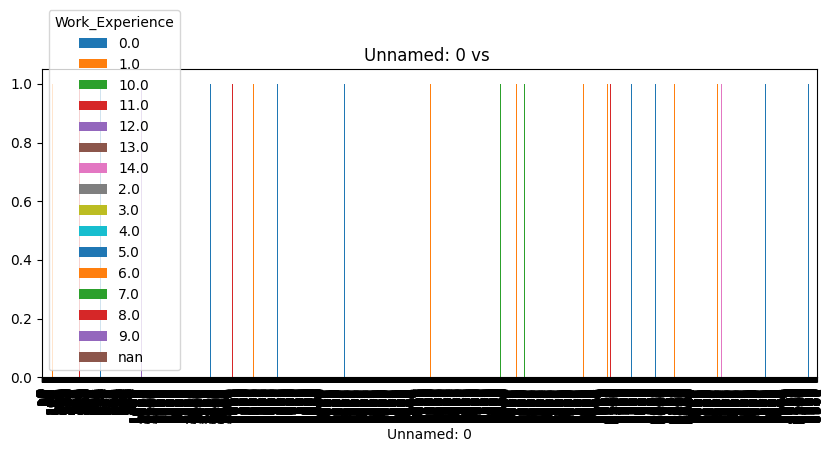

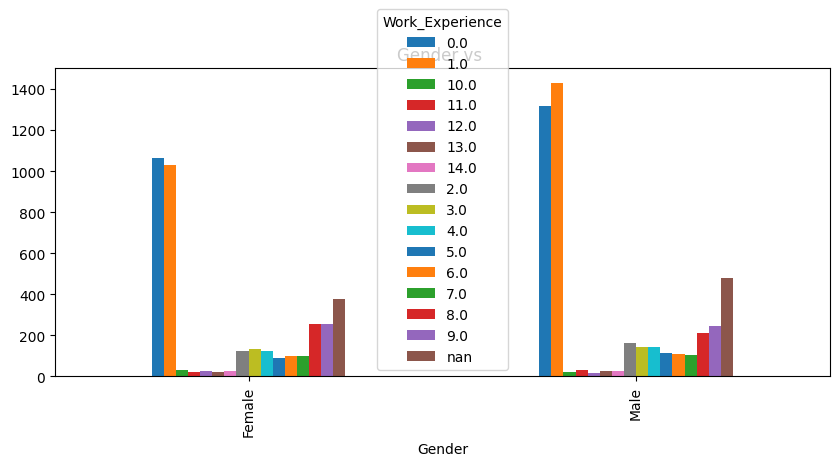

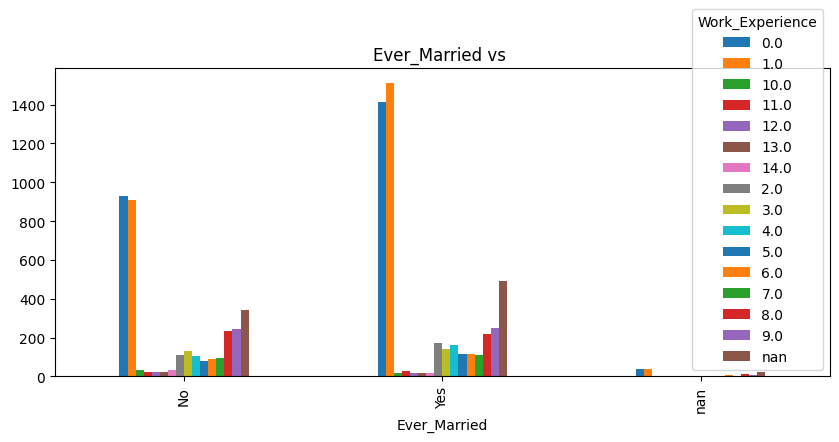

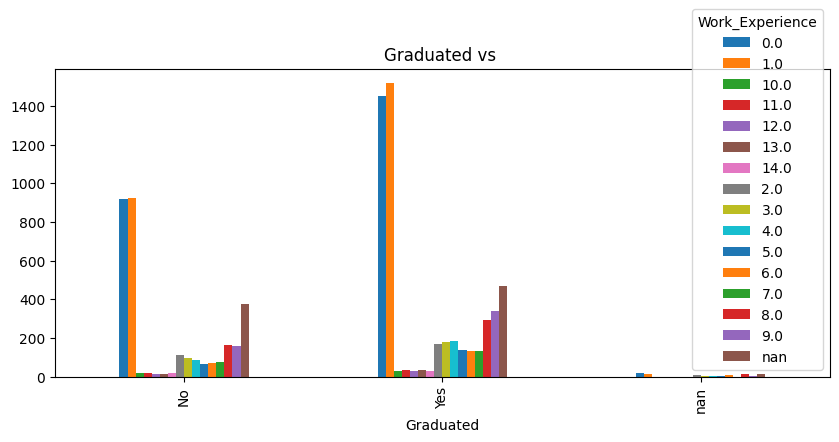

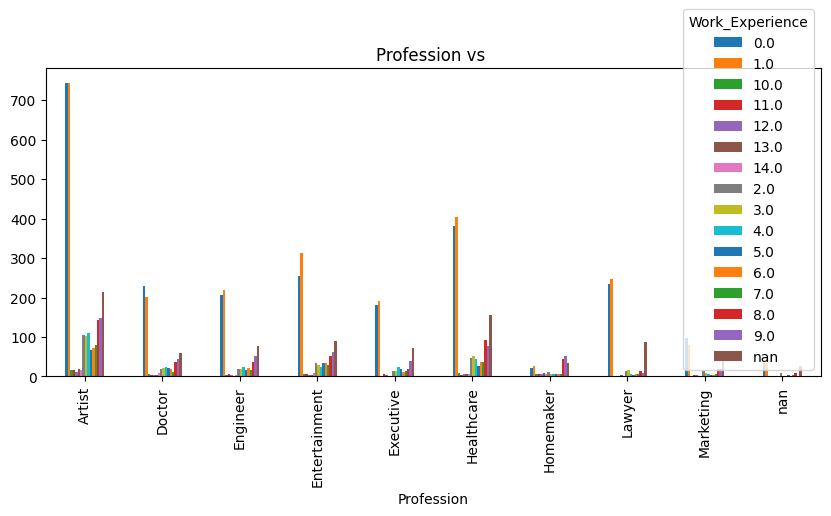

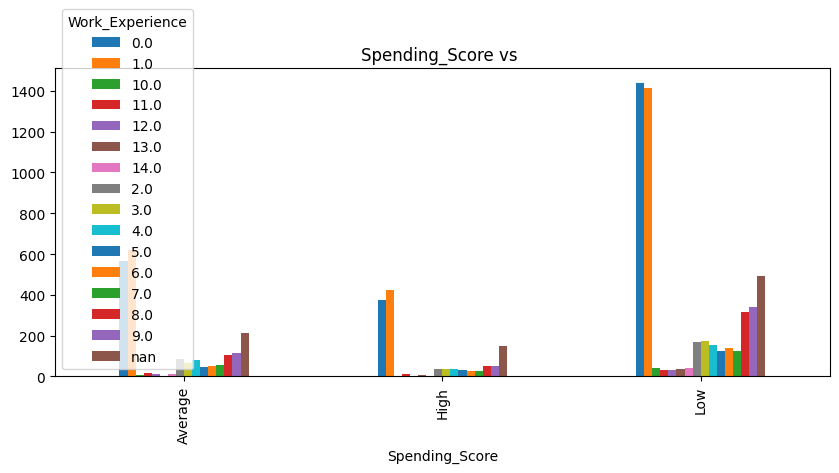

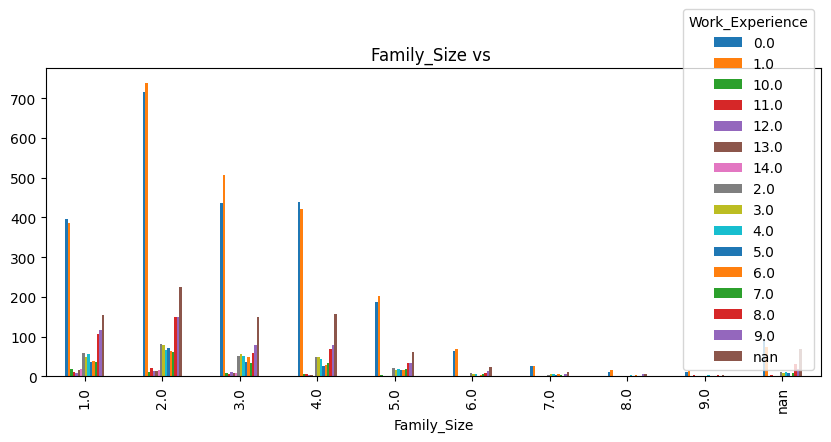

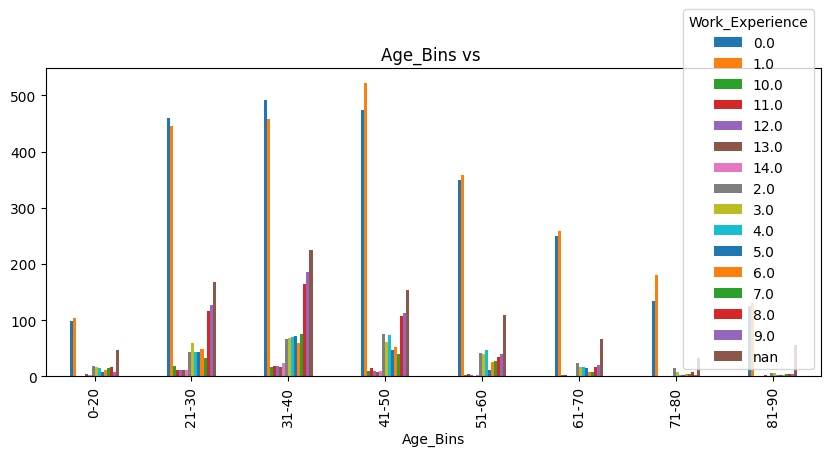

In [13]:
for col in dfcust.columns:
    if col not in ['Customer ID','Age','Work_Experience']:
        dfcust['Work_Experience'] = dfcust['Work_Experience'].astype('str').fillna('Unknown')  # Fill NaN with 'Unknown' for categorical columns
        pd.crosstab(dfcust[col], dfcust['Work_Experience']).plot(kind='bar', title=f'{col} vs ', figsize=(10, 4))
        

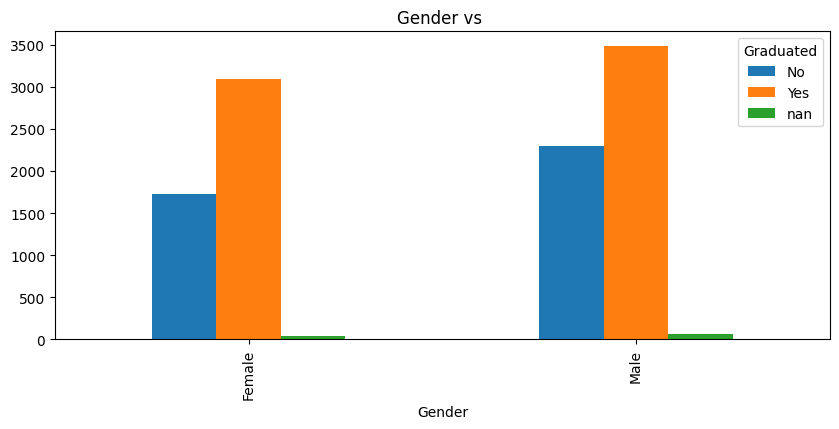

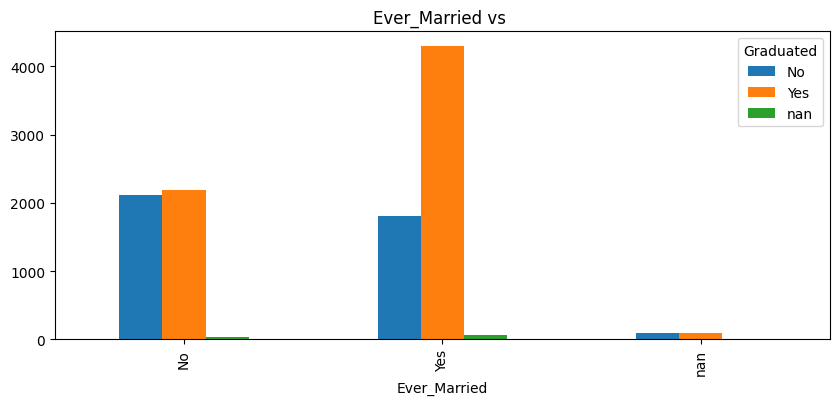

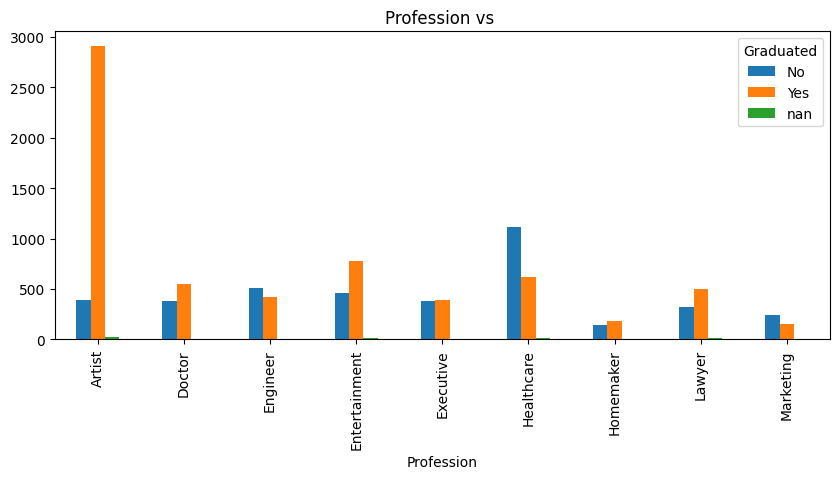

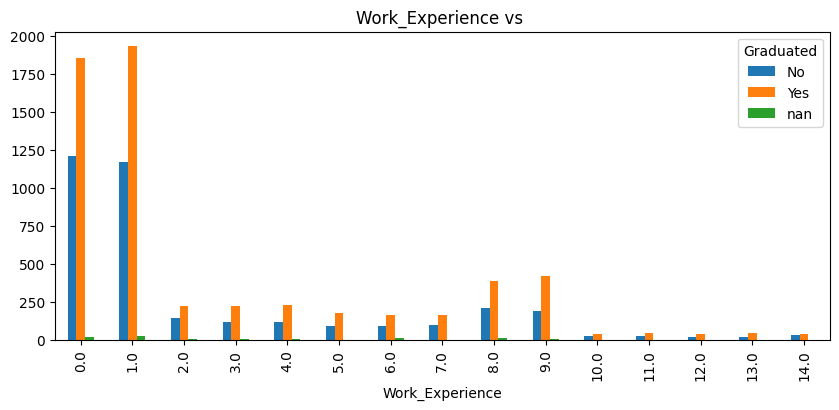

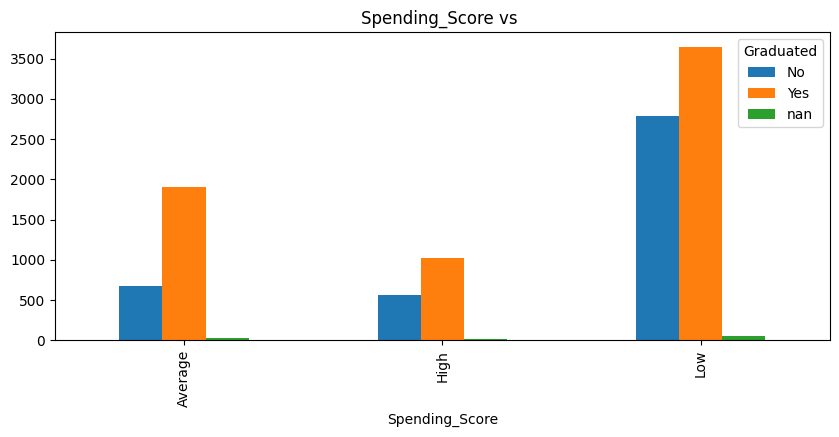

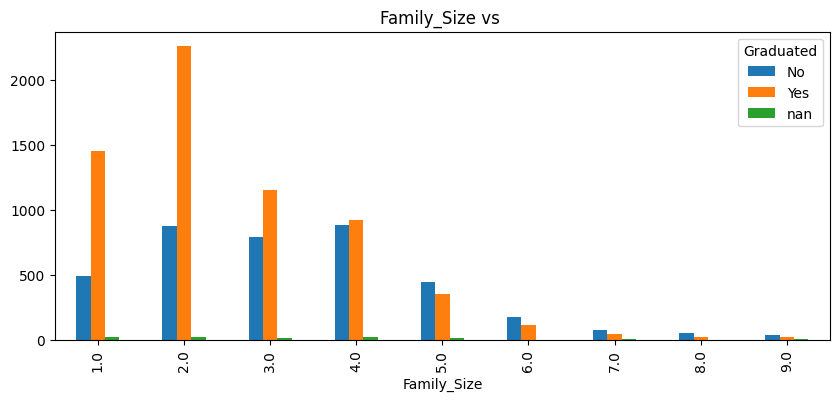

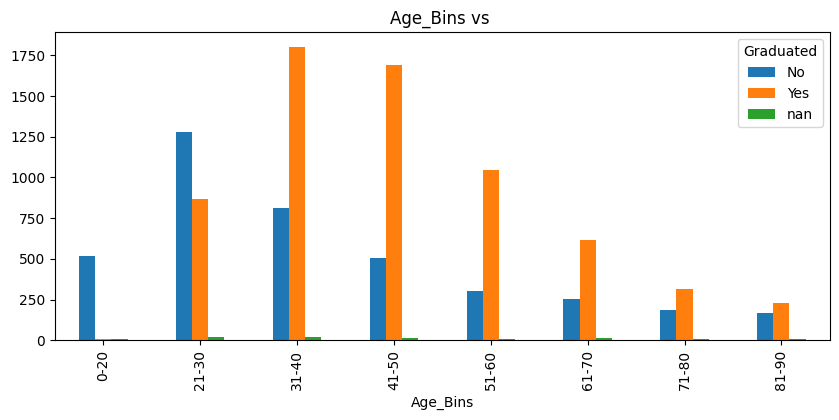

In [56]:
for col in dfcust.columns:
    if col not in ['Customer ID','Age','Graduated']:
        dfcust['Graduated'] = dfcust['Graduated'].astype('str').fillna('Unknown')  # Fill NaN with 'Unknown' for categorical columns
        pd.crosstab(dfcust[col], dfcust['Graduated']).plot(kind='bar', title=f'{col} vs ', figsize=(10, 4))
        

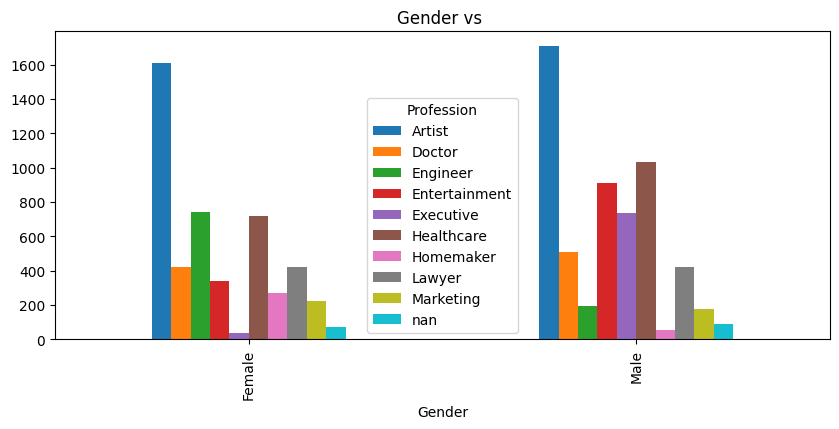

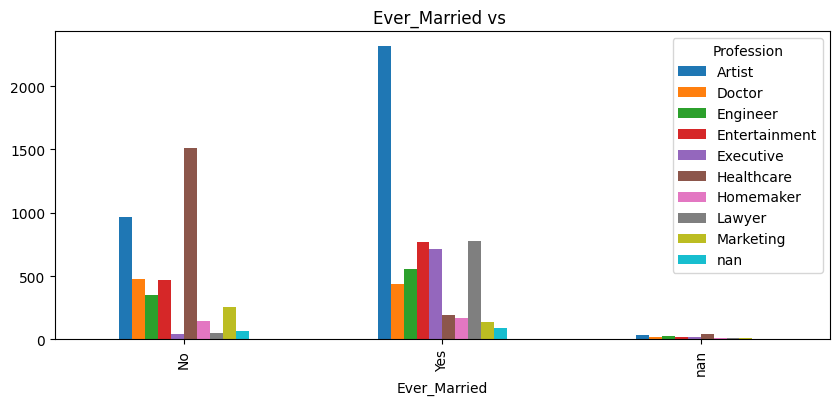

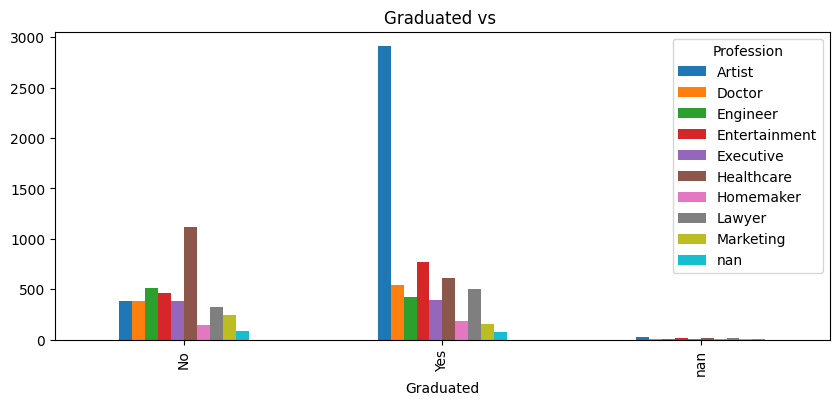

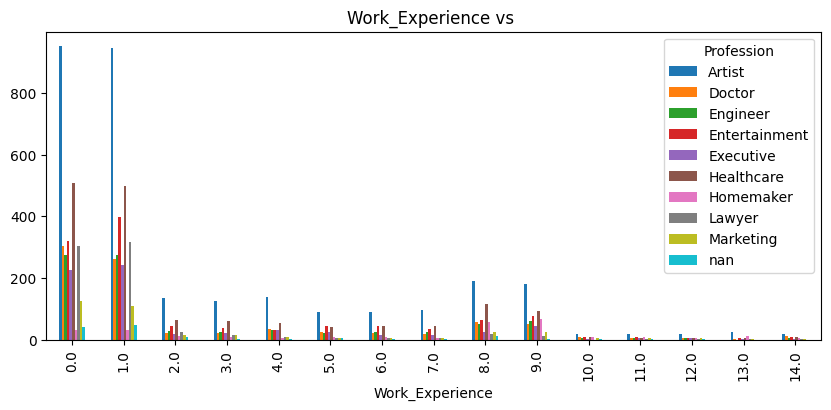

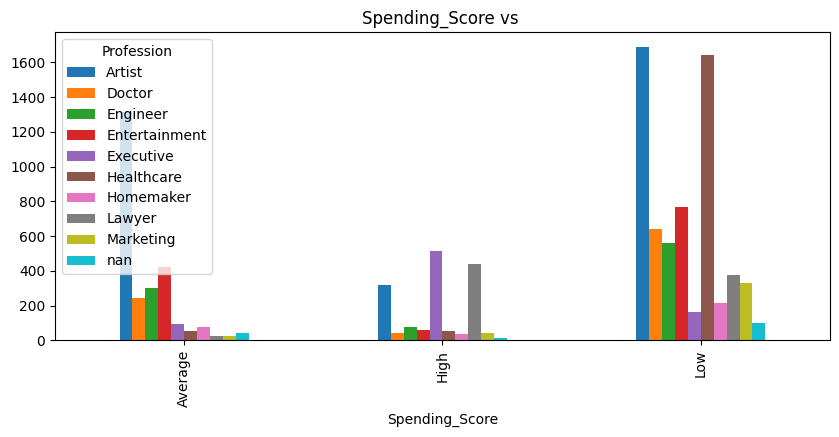

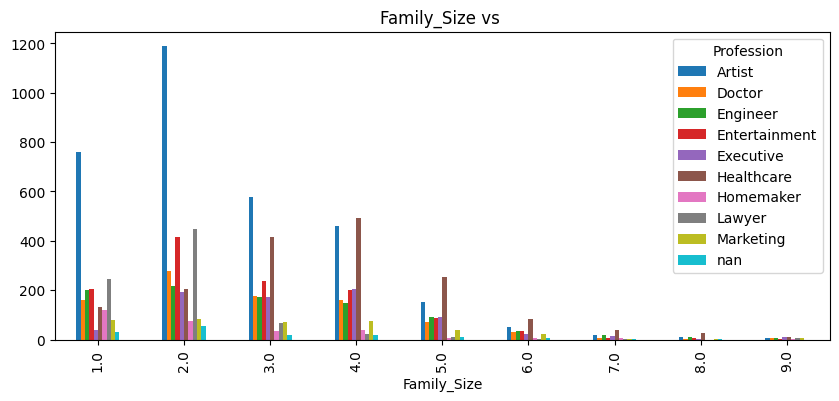

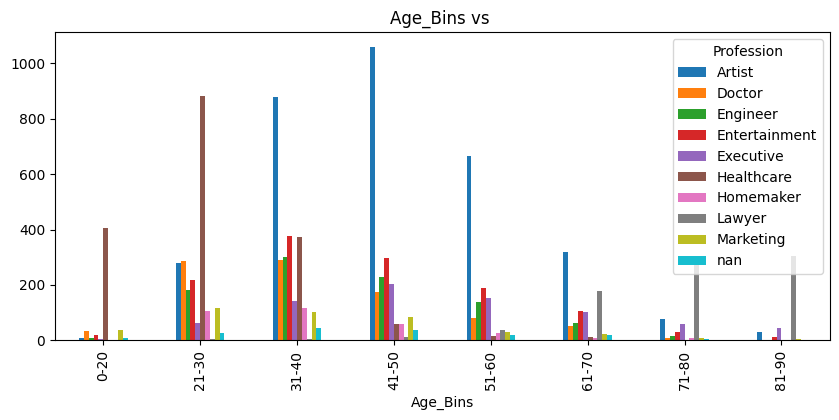

In [57]:
for col in dfcust.columns:
    if col not in ['Customer ID','Age','Profession']:
        dfcust['Profession'] = dfcust['Profession'].astype('str').fillna('Unknown')  # Fill NaN with 'Unknown' for categorical columns
        pd.crosstab(dfcust[col], dfcust['Profession']).plot(kind='bar', title=f'{col} vs ', figsize=(10, 4))
        

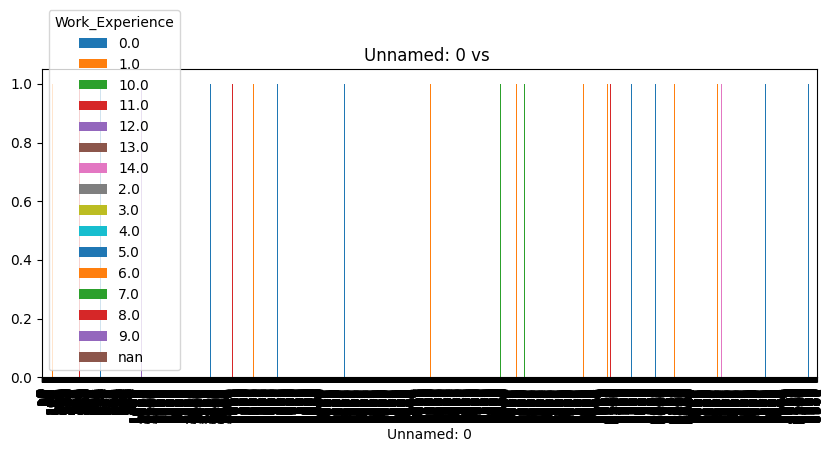

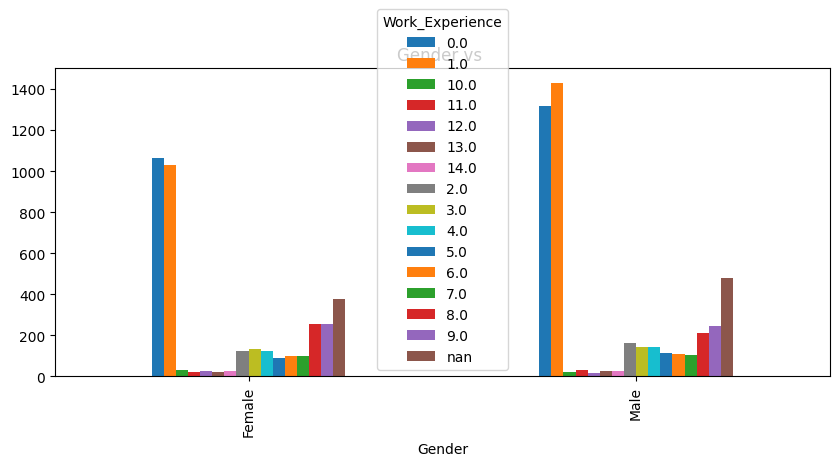

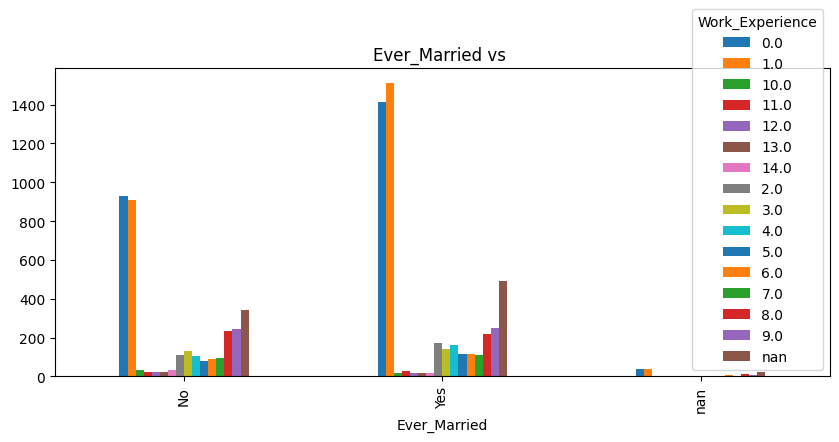

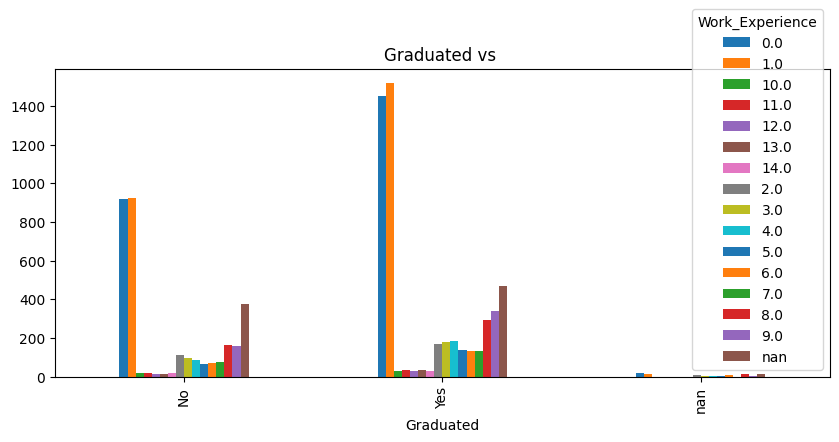

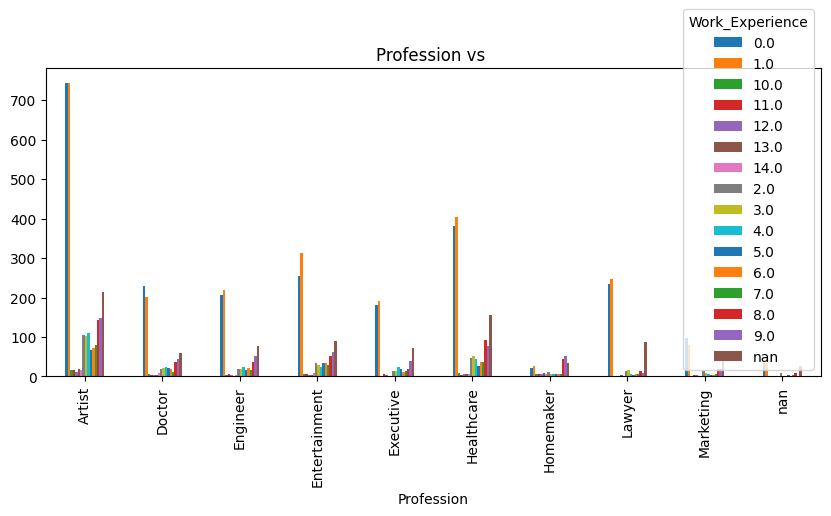

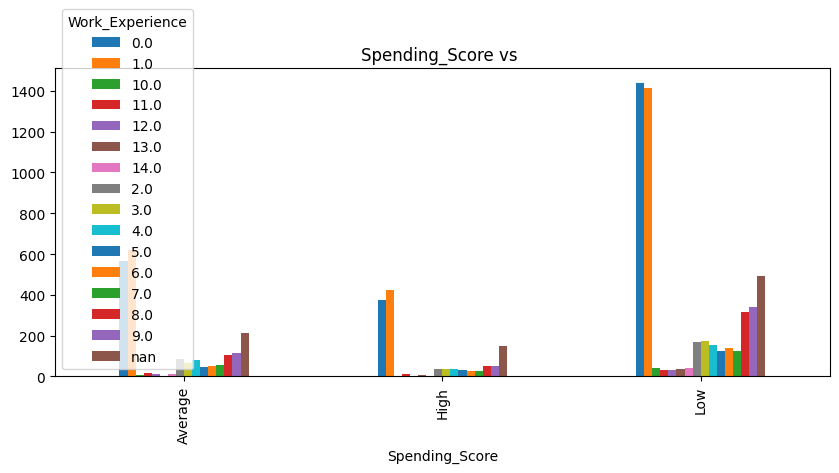

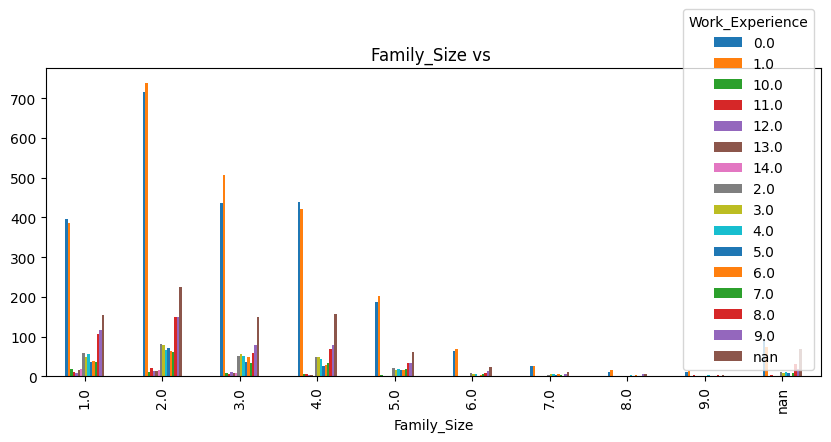

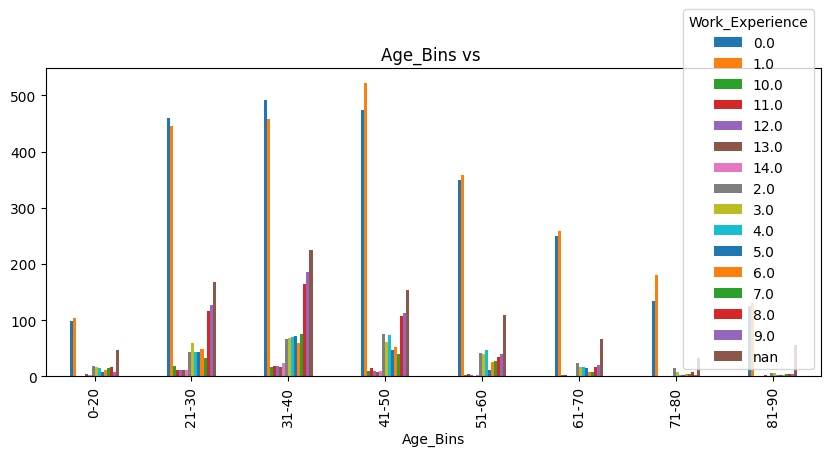

In [14]:
for col in dfcust.columns:
    if col not in ['Customer ID','Age','Work_Experience']:
        dfcust['Work_Experience'] = dfcust['Work_Experience'].astype('str').fillna('Unknown')  # Fill NaN with 'Unknown' for categorical columns
        pd.crosstab(dfcust[col], dfcust['Work_Experience']).plot(kind='bar', title=f'{col} vs ', figsize=(10, 4))
        

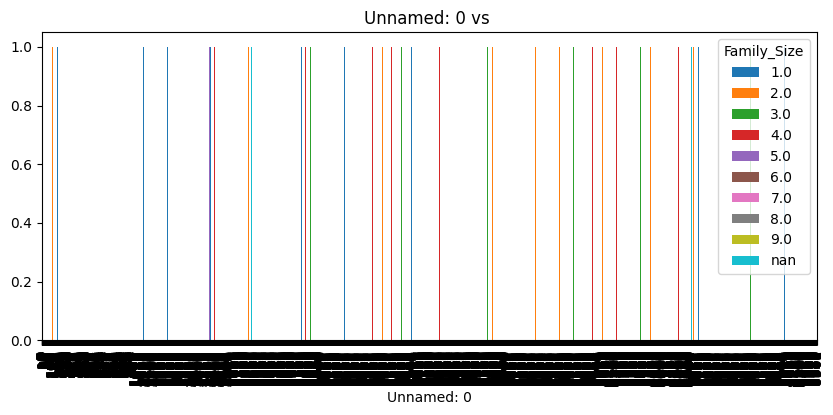

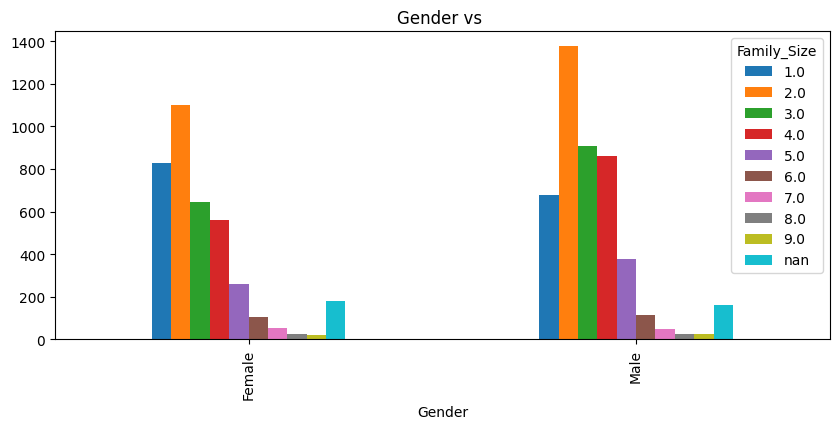

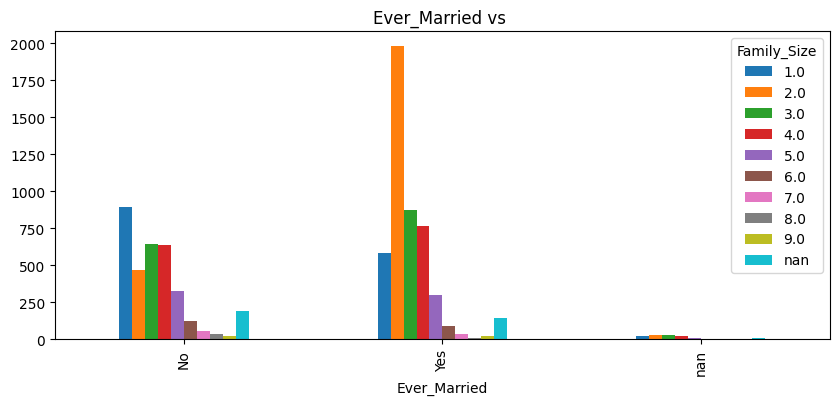

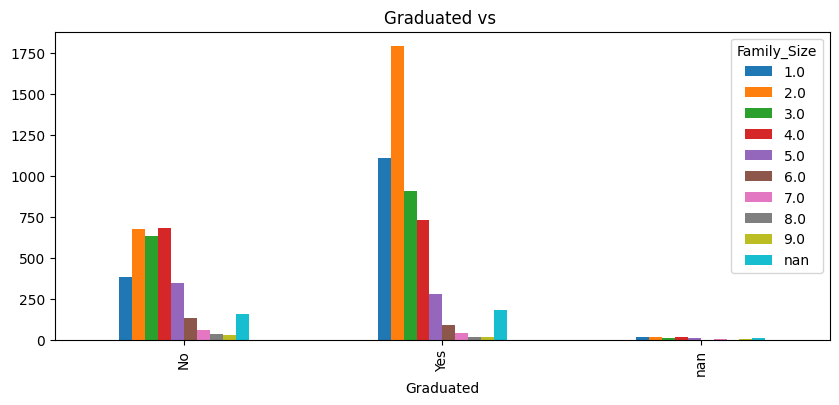

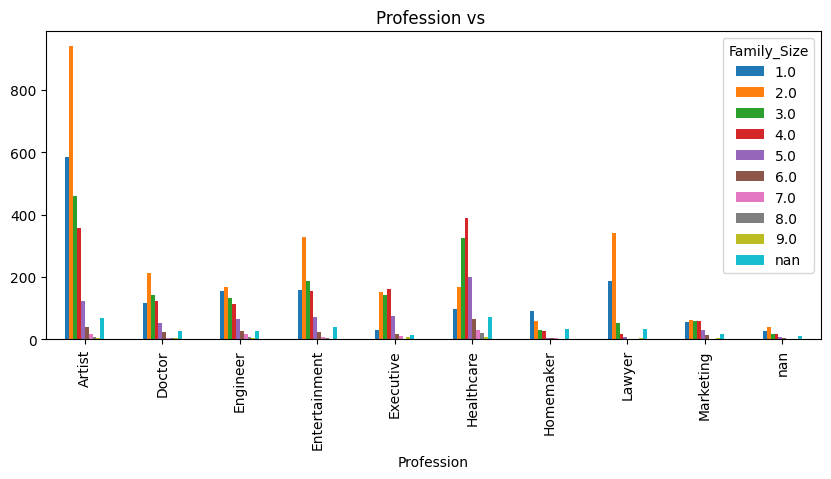

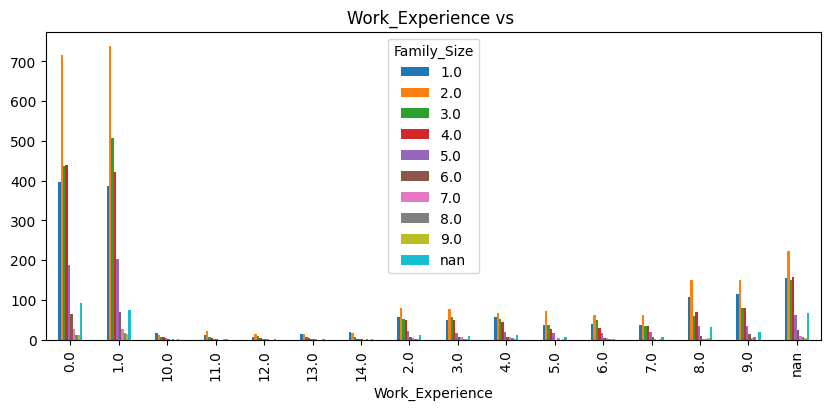

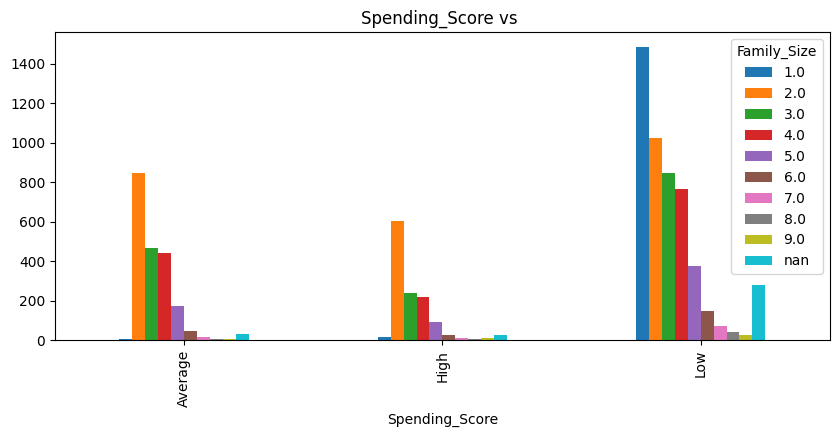

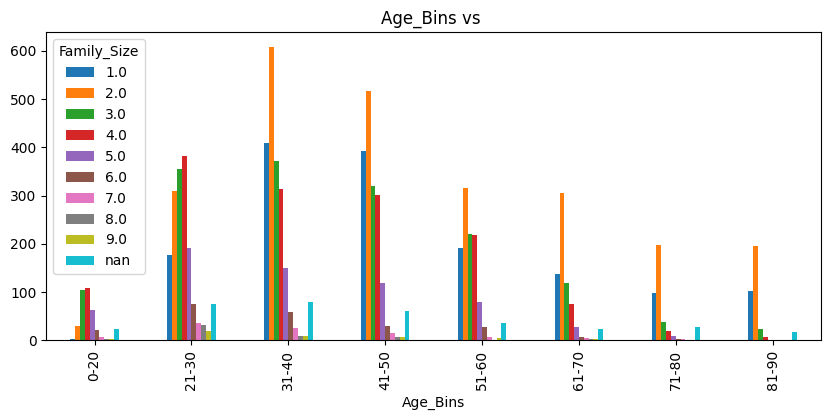

In [15]:
for col in dfcust.columns:
    if col not in ['Customer ID','Age','Family_Size']:
        dfcust['Family_Size'] = dfcust['Family_Size'].astype('str').fillna('Unknown')  # Fill NaN with 'Unknown' for categorical columns
        pd.crosstab(dfcust[col], dfcust['Family_Size']).plot(kind='bar', title=f'{col} vs ', figsize=(10, 4))
        

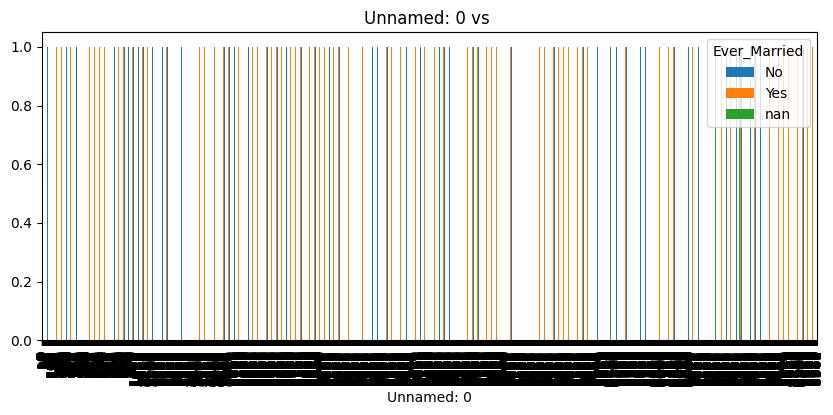

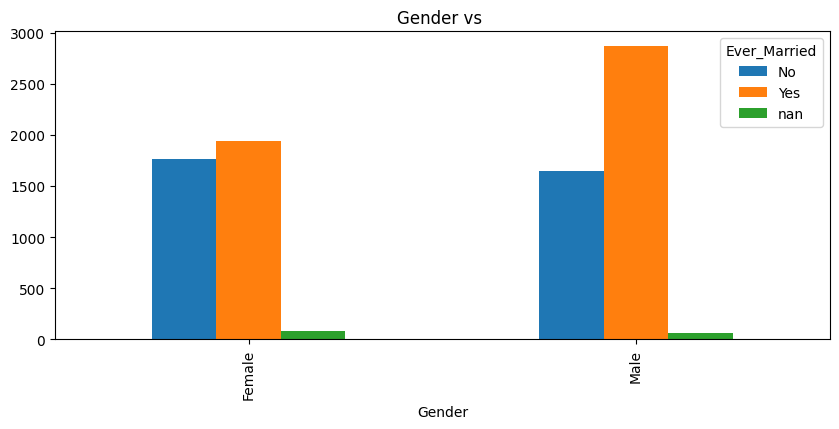

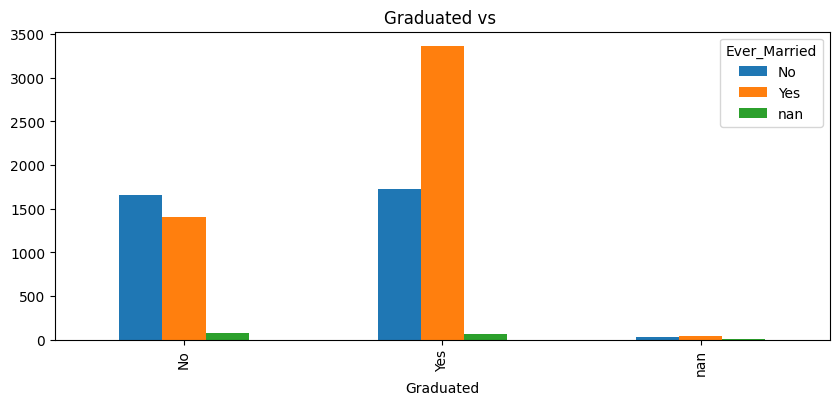

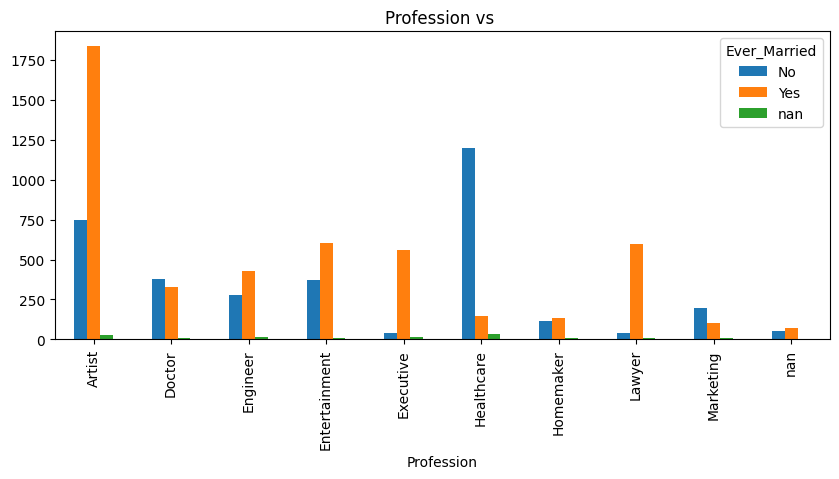

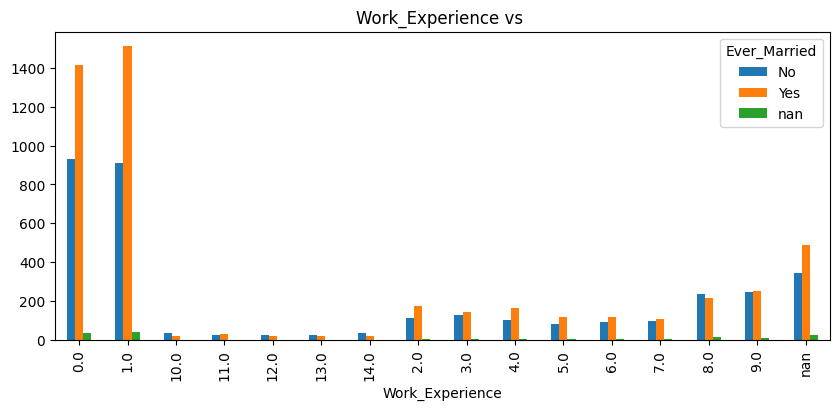

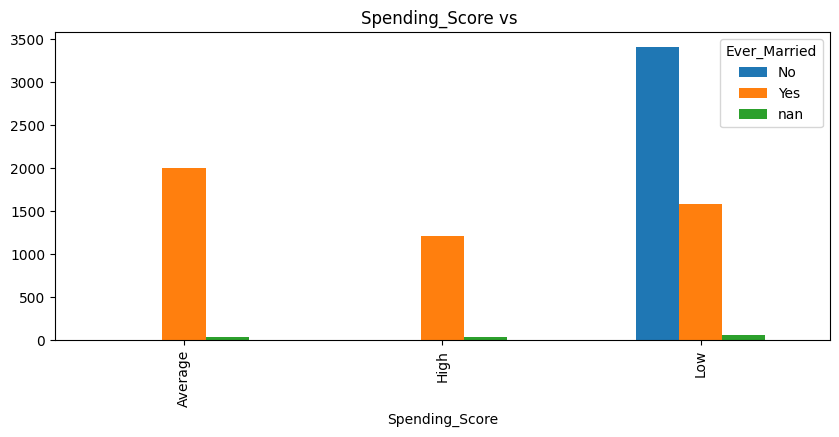

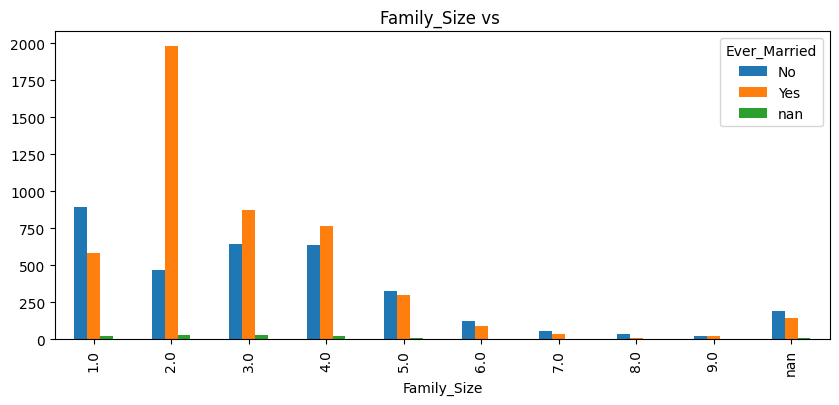

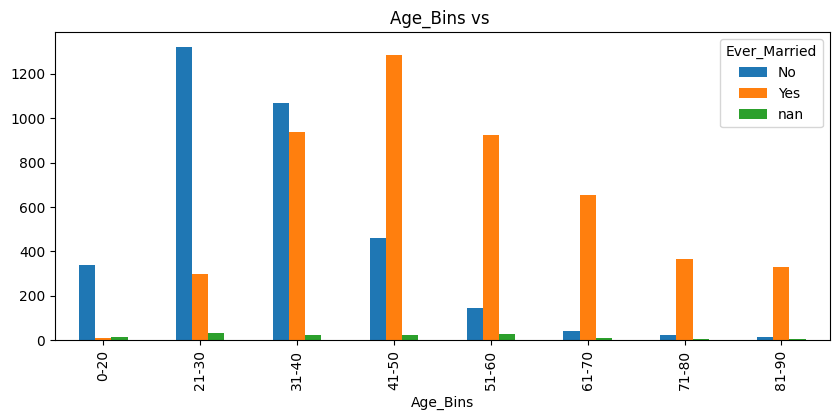

In [16]:
for col in dfcust.columns:
    if col not in ['Customer ID','Age','Ever_Married']:
        dfcust['Ever_Married'] = dfcust['Ever_Married'].astype('str').fillna('Unknown')  # Fill NaN with 'Unknown' for categorical columns
        pd.crosstab(dfcust[col], dfcust['Ever_Married']).plot(kind='bar', title=f'{col} vs ', figsize=(10, 4))
        